In [36]:
# CS180 (CS280A): Project 1 starter Python code

# these are just some suggested libraries
# instead of scikit-image you could use matplotlib and opencv to read, write, and display images

import numpy as np
import skimage as sk
import skimage.io as skio
import logging
import matplotlib.pyplot as plt
import skimage.exposure as exposure
import skimage.color as color
import os
import scipy
import cv2
import skimage.transform as transform
from skimage.draw import polygon
import imageio
from IPython.display import Image, display
import glob
import pandas as pd
import dlib

  # load the dlib model
detector = dlib.get_frontal_face_detector()
predictor_path = 'shape_predictor_68_face_landmarks.dat'  # Ensure this file is in your working directory
predictor = dlib.shape_predictor(predictor_path)
# set up logging
# levels are DEBUG, INFO, WARNING, ERROR, CRITICAL
# logging.basicConfig(level=logging.CRITICAL)


In [37]:
OUTPUT_PATH = '../../outputs/'
DATA_PATH = '../../../data/'

def load_image_as_float(imname):
    # concatenate the image name with the path
    imname = DATA_PATH + imname
    im = skio.imread(imname)
    # convert to float (might want to do this later on to save memory)
    im = sk.img_as_float(im)
    return im

def show_image(im, title=None):
    plt.figure()
    plt.imshow(im)
    plt.axis('off')
    if title is not None:
        plt.title(title)
    plt.show()

def export_image(im, imname, path=OUTPUT_PATH):
    # Convert RGBA to RGB if necessary
    if im.shape[-1] == 4:
        im = color.rgba2rgb(im)
    # convert to jpg
    im = sk.img_as_ubyte(im)
    fname = path + imname.split('.')[0] + '.jpg'
    skio.imsave(fname, im)

In [69]:
def show_image_with_points(image, points):
    plt.figure()
    plt.imshow(image)
    plt.scatter(points[:, 0], points[:, 1], c='r', marker='o')
    plt.title('Image with Points')
    plt.show()

def show_collection_of_images(images):
    plt.figure()
    for i, image in enumerate(images):
        plt.subplot(1, len(images), i+1)
        plt.imshow(image)
        plt.axis('off')
    plt.show()

def show_collection_of_images_with_titles(images, titles):
    plt.figure(figsize=(15, 5))  # Adjust figure size for better layout
    for i, image in enumerate(images):
        plt.subplot(1, len(images), i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(titles[i], wrap=True)  # Enable text wrapping
    plt.tight_layout()  # Adjust subplot layout
    plt.show()

In [38]:
# crop image from the bottom, to match target image ratio
def crop_image(im, target_im):
    # get the target ratio
    target_ratio = target_im.shape[0] / target_im.shape[1]
    # print("target_ratio: ", target_ratio)
    # get the aspect ratio of the image
    im_ratio = im.shape[0] / im.shape[1]
    # print("im_ratio: ", im_ratio)
    # crop the image to match the target ratio
    if im_ratio > target_ratio:
        # crop the image from the bottom
        im = im[:int(im.shape[1] * target_ratio), :]
    else:
        # crop the image from the right and left equally
        # Calculate the width to crop from each side
        # w1 - (h1*w2)/h2 = x
        crop_width = int((im.shape[1] - ((im.shape[0]*target_im.shape[1]) / target_im.shape[0])) / 2)
        # Crop the image from the right and left equally
        im = im[:, crop_width:-crop_width]

    # print("new ratio: ", im.shape[0] / im.shape[1])
    return im

In [39]:
def match_dimensions(changingImage, targetImage):
    # resize the changing image to match the target image dimensions
    changingImage = transform.resize(changingImage, targetImage.shape[:2])
    return changingImage

def addWhiteSpace(image, percent, direction):
    # add white space by the percent in the specified direction
    # direction is 'top', 'bottom', 'left', or 'right'
    # percent is a float between 0 and 1
    # add white space to the image
    if direction == 'top':
        image = np.pad(image, ((int(image.shape[0] * percent), 0), (0, 0), (0, 0)))
    elif direction == 'bottom':
        image = np.pad(image, ((0, int(image.shape[0] * percent)), (0, 0), (0, 0)))
    elif direction == 'left':
        image = np.pad(image, ((0, 0), (int(image.shape[1] * percent), 0), (0, 0)))
    elif direction == 'right':
        image = np.pad(image, ((0, 0), (0, int(image.shape[1] * percent)), (0, 0)))
    return image

cropped_ethan shape:  (862, 704, 4)
mahomes shape:  (862, 704, 4)


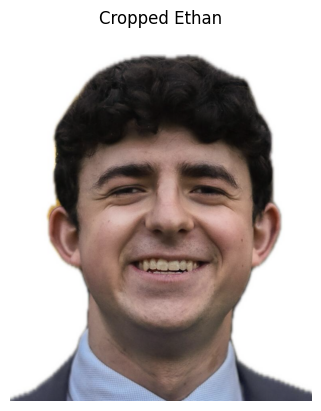

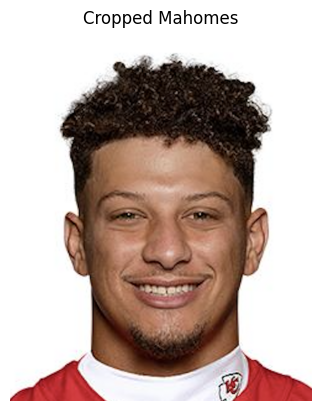

In [79]:
ethan = load_image_as_float('input_ethan.png')
mahomes = load_image_as_float('input_mahomes.png')

# show_image(ethan, 'Ethan')
# show_image(mahomes, 'Mahomes')

cropped_ethan = crop_image(ethan, mahomes)

# add white space
# cropped_ethan = addWhiteSpace(cropped_ethan, 0.05, 'top')

# match dimensions
cropped_ethan = match_dimensions(cropped_ethan, mahomes)
print("cropped_ethan shape: ", cropped_ethan.shape)
print("mahomes shape: ", mahomes.shape)

show_image(cropped_ethan, 'Cropped Ethan')
show_image(mahomes, 'Cropped Mahomes')

export_image(cropped_ethan, 'cropped_ethan', path=OUTPUT_PATH)
export_image(mahomes, 'cropped_mahomes', path=OUTPUT_PATH)


# Part 1 Defining Correspondences

len of im1Points:  58


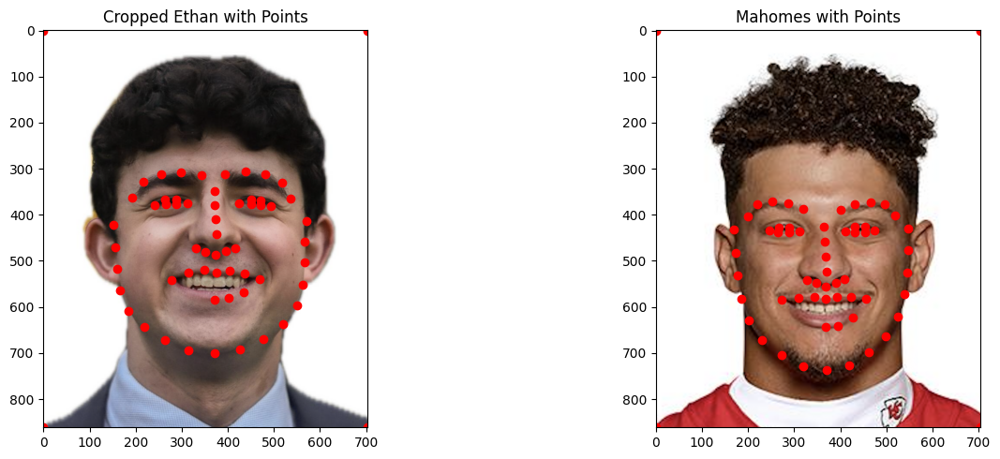

<Figure size 640x480 with 0 Axes>

In [41]:
# import json
import json

def import_correspondences(im1_name, im2_name, im1, im2):
    # load the json file
    with open(DATA_PATH + f'{im1_name}_{im2_name}.json', 'r') as f:
        correspondences = json.load(f)

    # get the points
    im1Points = correspondences['im1Points']
    im2Points = correspondences['im2Points']
    print("len of im1Points: ", len(im1Points))

    # add points to the corner of each image
    im1Points.append((0, 0))
    im2Points.append((0, 0))
    im1Points.append((0, im1.shape[0]-1))
    im2Points.append((0, im2.shape[0]-1))
    im1Points.append((im1.shape[1]-1, 0))
    im2Points.append((im2.shape[1]-1, 0))
    im1Points.append((im1.shape[1]-1, im1.shape[0]-1))
    im2Points.append((im2.shape[1]-1, im2.shape[0]-1))
    # calculate midway points without using for loops
    im1Points = np.array(im1Points)
    im2Points = np.array(im2Points) 

    return im1Points, im2Points

im1Points, im2Points = import_correspondences('cropped_ethan', 'cropped_mahomes', cropped_ethan, mahomes)


midway_points = (im1Points + im2Points) // 2


# show images with points on them with titles
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
axes[0].imshow(cropped_ethan)
axes[0].scatter(im1Points[:, 0], im1Points[:, 1], c='r', marker='o')
axes[0].set_title('Cropped Ethan with Points')
axes[1].imshow(mahomes)
axes[1].scatter(im2Points[:, 0], im2Points[:, 1], c='r', marker='o')
axes[1].set_title('Mahomes with Points')
# axes[2].imshow((mahomes + cropped_ethan) / 2)
# axes[2].scatter(midway_points[:, 0], midway_points[:, 1], c='r', marker='o')
# axes[2].set_title('Unwarped Midway Image with Midway Points')
plt.tight_layout()
plt.show()

# export the plot
plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_PATH, 'correspondences.png'))
plt.close(fig) 





tri.simplices:  [[ 0 59 58]
 [60 20 58]
 [ 8 61 59]
 [61 16 60]
 [17  0 58]
 [18 17 58]
 [20 19 58]
 [19 18 58]
 [23 20 60]
 [24 23 60]
 [25 24 60]
 [ 7  8 59]
 [ 6  7 59]
 [ 4  5 59]
 [ 5  6 59]
 [ 3  4 59]
 [ 2  3 59]
 [23 21 20]
 [16 26 60]
 [26 25 60]
 [11 12 61]
 [10 11 61]
 [ 8  9 61]
 [ 9 10 61]
 [15 16 61]
 [14 15 61]
 [12 13 61]
 [13 14 61]
 [19 37 18]
 [37 19 20]
 [ 0  1 59]
 [ 1  2 59]
 [25 44 24]
 [44 23 24]
 [22 21 23]
 [36 17 18]
 [37 36 18]
 [36 37 41]
 [17 36  0]
 [36  1  0]
 [21 38 20]
 [38 37 20]
 [ 5 48  6]
 [48  5  4]
 [ 3 48  4]
 [48  3  2]
 [ 1 48  2]
 [48 36 41]
 [36 48  1]
 [ 7 57  8]
 [57  7  6]
 [48 57  6]
 [57 48 49]
 [44 43 23]
 [43 22 23]
 [22 43 42]
 [26 45 25]
 [45 44 25]
 [45 26 16]
 [15 45 16]
 [39 38 21]
 [54 13 12]
 [11 54 12]
 [13 54 14]
 [47 43 44]
 [43 47 42]
 [39 27 28]
 [27 39 21]
 [22 27 21]
 [27 42 28]
 [27 22 42]
 [39 40 38]
 [37 40 41]
 [38 40 37]
 [55 11 10]
 [55 54 11]
 [35 15 14]
 [54 35 14]
 [35 45 15]
 [47 35 42]
 [ 9 56 10]
 [56 55 10]


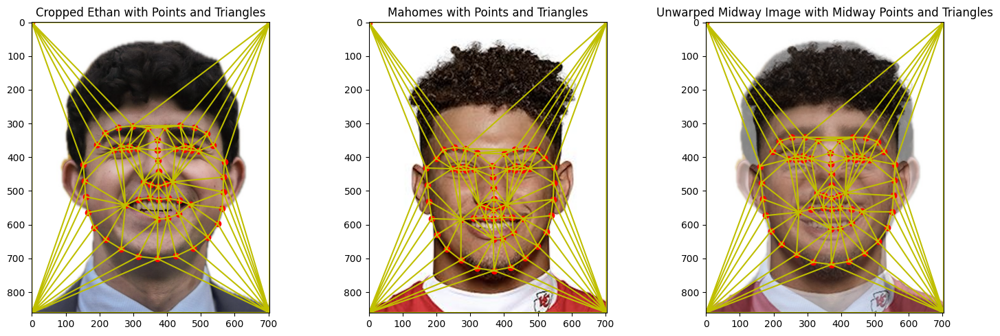

In [42]:
# Delauney triangulation
def delauneyTriangulation(midway_points):
    tri = scipy.spatial.Delaunay(midway_points)
    return tri
tri = delauneyTriangulation(midway_points)
print("tri.simplices: ", tri.simplices)

# show images with points and triangles on them with titles
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Cropped Ethan
axes[0].imshow(cropped_ethan)
axes[0].scatter(im1Points[:, 0], im1Points[:, 1], c='r', marker='o')
axes[0].triplot(im1Points[:, 0], im1Points[:, 1], tri.simplices, 'y-')
axes[0].set_title('Cropped Ethan with Points and Triangles')

# Mahomes
axes[1].imshow(mahomes)
axes[1].scatter(im2Points[:, 0], im2Points[:, 1], c='r', marker='o')
axes[1].triplot(im2Points[:, 0], im2Points[:, 1], tri.simplices, 'y-')
axes[1].set_title('Mahomes with Points and Triangles')

# Midway Image
midway_image = (mahomes + cropped_ethan) / 2
axes[2].imshow(midway_image)
axes[2].scatter(midway_points[:, 0], midway_points[:, 1], c='r', marker='o')
axes[2].triplot(midway_points[:, 0], midway_points[:, 1], tri.simplices, 'y-')
axes[2].set_title('Unwarped Midway Image with Midway Points and Triangles')

plt.tight_layout()
plt.show()



# Part 2: Computing the mid-way face

## affine transformation derivation


$$\begin{bmatrix}
x'\\ 
y'\\ 
1
\end{bmatrix} = 
\begin{bmatrix}
a &b  &c \\ 
d &e  &f \\ 
0 &0  &1 
\end{bmatrix}
\begin{bmatrix}
x\\ 
y\\ 
1
\end{bmatrix}$$


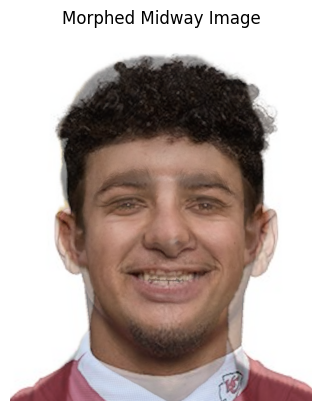

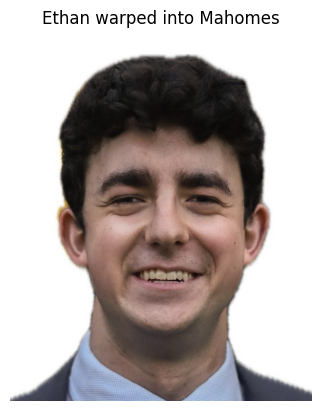

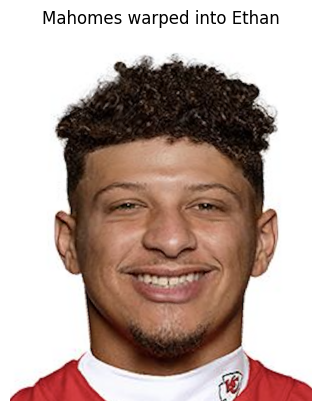

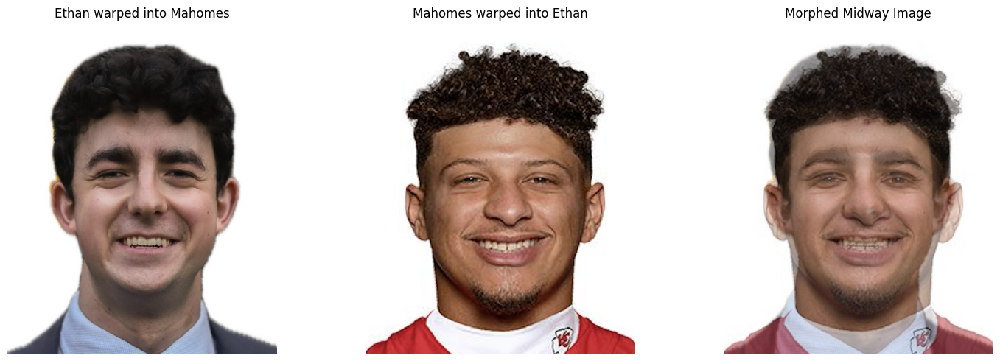

In [70]:
def computeAffine(tri1_pts, tri2_pts):
    # x1, y1, x2, y2, x3, y3
    # compute the affine matrix (no for loops)
    A = np.zeros((2, 3))
    # define points to go into A
    (x1, y1), (x2, y2), (x3, y3) = tri1_pts
    (x1p, y1p), (x2p, y2p), (x3p, y3p) = tri2_pts
    # define variables for matrix
    a11, a12, a21, a22, b1, b2 = 0, 0, 0, 0, 0, 0
    # define matrix form of equations
    # Define the matrix equation: AX = B
    # Where A is the matrix of coordinates, X is the affine transformation parameters, and B is the transformed coordinates
    A = np.array([
        [x1, y1, 0, 0, 1, 0],
        [0, 0, x1, y1, 0, 1],
        [x2, y2, 0, 0, 1, 0],
        [0, 0, x2, y2, 0, 1],
        [x3, y3, 0, 0, 1, 0],
        [0, 0, x3, y3, 0, 1]
    ])
    
    B = np.array([x1p, y1p, x2p, y2p, x3p, y3p])
    
    # Solve the equation AX = B
    X = np.linalg.lstsq(A, B, rcond=1e-6)[0]
    
    # Extract the affine transformation parameters
    a11, a12, a21, a22, b1, b2 = X
    
    # Construct the affine transformation matrix
    A = np.array([[a11, a12, b1],
                  [a21, a22, b2],
                  [0, 0, 1]])
    
    return A

# def applyAffine(im, A):

def morphTriangle(tri1_pts, tri2_pts, src_img, dst_img):

    # get the affine matrix
    A = computeAffine(tri1_pts, tri2_pts)
    A_inv = np.linalg.pinv(A)

    row1_values = [tuple[1] for tuple in tri1_pts]
    col1_values = [tuple[0] for tuple in tri1_pts]
    row2_values = [tuple[1] for tuple in tri2_pts]
    col2_values = [tuple[0] for tuple in tri2_pts]

    # use polygon to generate a mask of the triangle
        # polygon(row, col) returns a list of indices inside the polygon
    oldPolyY, oldPolyX = polygon(row1_values, col1_values)
    newPolyY, newPolyX = polygon(row2_values, col2_values)

    # # plot the polygon
    # plt.figure()
    # plt.imshow(src_img)
    # plt.plot(oldPolyX, oldPolyY, 'r-')
    # plt.plot(newPolyX, newPolyY, 'b-')
    # plt.show()

    # clip values to be within the bounds of the image
    oldPolyX = np.clip(oldPolyX, 0, src_img.shape[1]-1)
    oldPolyY = np.clip(oldPolyY, 0, src_img.shape[0]-1)
    newPolyX = np.clip(newPolyX, 0, dst_img.shape[1]-1)
    newPolyY = np.clip(newPolyY, 0, dst_img.shape[0]-1)

    # stack coordinates with a 1 to convert to homogenous coordinates
    stackedPixelMatrix = np.vstack((newPolyX, newPolyY, np.ones(len(newPolyX))))
    # apply the inverse affine matrix to the polygon of the new image, then truncate the 1 to convert back to cartesian coordinates
    colorSeekingPixels = (A_inv @ stackedPixelMatrix)[:2]

    # # plot the polygon
    # plt.figure()
    # plt.imshow(src_img)
    # plt.plot(colorSeekingPixels[0], colorSeekingPixels[1], 'r-')
    # plt.show()

    # prepare inputs for griddata
    points = np.vstack((oldPolyX, oldPolyY)).T # shape (2, n)
    values = src_img[oldPolyY, oldPolyX] # shape (n, 3)
    seekingPoints = colorSeekingPixels.T # shape (m, 2)

    # use interpolation to get the colors from the og image
    # griddate(points, values, seekingpoints, method)
    # print("points.shape: ", points.shape)
    # print("values.shape: ", values.shape)
    # print("seekingPoints.shape: ", seekingPoints.shape)
    newColors = scipy.interpolate.griddata(points, values, seekingPoints, method='nearest')

    # Add this check after griddata
    if newColors is not None and len(newColors) > 0:
        dst_img[newPolyY, newPolyX] = newColors
    else:
        print("No valid colors found for some pixels.")

    # set the pixels of the new image to the colors of the og image
    dst_img[newPolyY, newPolyX] = newColors



def morphImage(points, midway_points, src_img, tri):
    dst_img = np.zeros_like(src_img)
    # make dst img way bigger
    # dst_img = np.pad(dst_img, ((100, 100), (100, 100), (0, 0)))
    for triangle in tri.simplices:
        # define points from the image
        p1, p2, p3 = points[triangle]
        # define points from the midway image
        mp1, mp2, mp3 = midway_points[triangle]
        # morph the triangle
        # print("triangle: ", triangle)
        # print("tri points: ", p1, p2, p3)
        # print("midway points: ", mp1, mp2, mp3)
        morphTriangle([p1, p2, p3], [mp1, mp2, mp3], src_img, dst_img)
    return dst_img


def morphImages(im1Points, im2Points, src_img, target_img, warp_amount=0.5,dissolve_amount=0.5, tri=None):
    if src_img.shape[2] == 4:
        src_img = color.rgba2rgb(src_img)
    if target_img.shape[2] == 4:
        target_img = color.rgba2rgb(target_img)
    if src_img.shape != target_img.shape:
        src_img = transform.resize(src_img, target_img.shape[:2])
    # compute the average shape (midway points)
    midway_points = im1Points * (1 - warp_amount) + im2Points * warp_amount
    if tri is None:
        tri = delauneyTriangulation(midway_points)

    dst_img1 = morphImage(im1Points, midway_points, src_img, tri)
    dst_img2 = morphImage(im2Points, midway_points, target_img, tri)

    # blend the images
    blended_image = dst_img1 * (1-dissolve_amount) + dst_img2 * dissolve_amount

    return blended_image, dst_img1, dst_img2


morphed_image, dst_img1, dst_img2 = morphImages(im1Points, im2Points, cropped_ethan, mahomes, warp_amount=0.5, dissolve_amount=0.5)


show_image(morphed_image, 'Morphed Midway Image')
show_image(dst_img1, 'Ethan warped into Mahomes')
show_image(dst_img2, 'Mahomes warped into Ethan')

show_collection_of_images_with_titles([dst_img1, dst_img2, morphed_image], ['Ethan warped into Mahomes', 'Mahomes warped into Ethan', 'Morphed Midway Image'])

export_image(morphed_image, 'morphed_midway_image', path=OUTPUT_PATH)
export_image(dst_img1, 'ethan_warped_into_mahomes', path=OUTPUT_PATH)
export_image(dst_img2, 'mahomes_warped_into_ethan', path=OUTPUT_PATH)


# Part 3: Morphing video

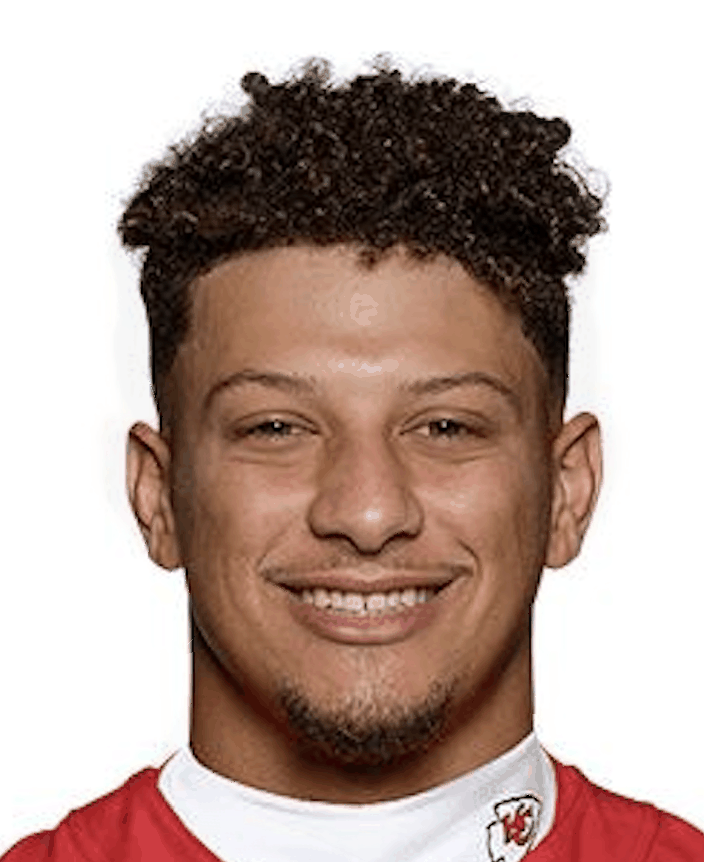

In [44]:
def morphVideo(im1Points, im2Points, src_img, target_img, num_frames=30):
    tri = delauneyTriangulation(im1Points)
    images = []
    from concurrent.futures import ThreadPoolExecutor, as_completed
    
    def process_frame(i, num_frames, im1Points, im2Points, src_img, target_img, tri):
        amount = i / num_frames
        morphed_image, _, _ = morphImages(im1Points, im2Points, src_img, target_img, warp_amount=amount, dissolve_amount=amount, tri=tri)
        return i, (morphed_image * 255).astype(np.uint8)
    
    with ThreadPoolExecutor() as executor:
        futures = [executor.submit(process_frame, i, num_frames, im1Points, im2Points, src_img, target_img, tri) for i in range(num_frames)]
        
        # Collect results in order
        results = []
        for future in as_completed(futures):
            results.append(future.result())
        
    # Sort results by frame index and extract images
    images = [img for _, img in sorted(results)]
    return images

images = morphVideo(im1Points, im2Points, cropped_ethan, mahomes)

# make the images bounce by concatenating the images in reverse
images = images[::-1] + images[1:]

# show the images as a gif
imageio.mimsave('morph.gif', images, duration=0.1, loop=0, format='GIF-PIL')

# display the gif
display(Image(filename='morph.gif'))

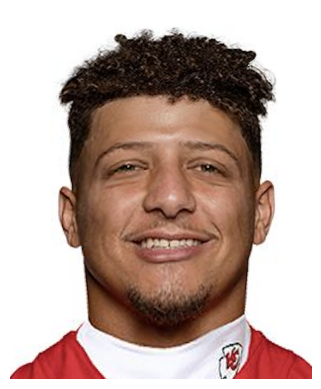

In [45]:
show_image(morphImages(im1Points, im2Points, cropped_ethan, mahomes, warp_amount=0, dissolve_amount=1)[0])
# Part 4: The mean face of a population

# Part 4: The mean face of a population

In [46]:
# figure out how the points are formatted

# load the points
asf_files = glob.glob(DATA_PATH + '/danes/*.asf')
print("asf_files: ", asf_files)

asf_files:  ['../../../data//danes/08-1f.asf', '../../../data//danes/11-1m.asf', '../../../data//danes/39-1m.asf', '../../../data//danes/27-1m.asf', '../../../data//danes/01-1m.asf', '../../../data//danes/13-1m.asf', '../../../data//danes/25-1m.asf', '../../../data//danes/37-1m.asf', '../../../data//danes/29-1m.asf', '../../../data//danes/30-1f.asf', '../../../data//danes/22-1f.asf', '../../../data//danes/14-1f.asf', '../../../data//danes/33-1m.asf', '../../../data//danes/21-1m.asf', '../../../data//danes/17-1m.asf', '../../../data//danes/09-1m.asf', '../../../data//danes/05-1m.asf', '../../../data//danes/12-1f.asf', '../../../data//danes/40-1m.asf', '../../../data//danes/23-1m.asf', '../../../data//danes/31-1m.asf', '../../../data//danes/19-1m.asf', '../../../data//danes/07-1m.asf', '../../../data//danes/34-1m.asf', '../../../data//danes/26-1m.asf', '../../../data//danes/38-1m.asf', '../../../data//danes/10-1m.asf', '../../../data//danes/15-1f.asf', '../../../data//danes/24-1m.asf', '

In [47]:
corner_points = np.array([[1 , 1 ],
                           [639, 1],
                           [1, 479],
                           [639, 479]]) # image size 640 x 480 (-1)


# Parse through the files and extract the points
dataset_images = []
for filename in asf_files:
    # Read the ASF file, skipping header and footer
    df = pd.read_csv(filename, sep='\t', skiprows=range(16), skipfooter=5, engine='python', header=None)
    
    # Extract and scale points
    points = df[[2, 3]].values * [640, 480]
    
    # Add corner points
    points = np.vstack((points, corner_points))
    
    # Construct image filename and read image
    img_name = f"{os.path.splitext(filename)[0]}.bmp"
    img = sk.img_as_float(skio.imread(img_name))
    
    # Append to dataset
    dataset_images.append({
        'points': points,
        'image': img
    })

# Print summary
print(f"Processed {len(dataset_images)} images")

Processed 37 images


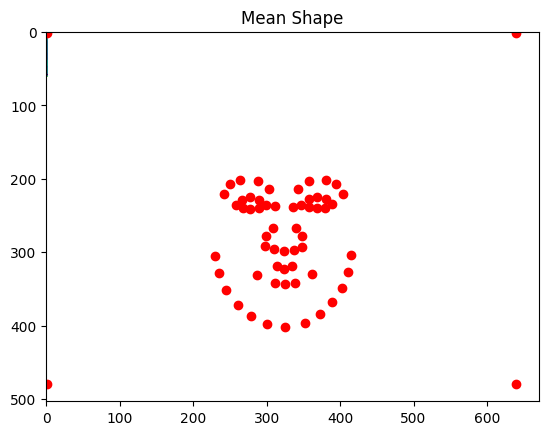

In [48]:
# calculate the mean shape
mean_points = np.mean([img['points'] for img in dataset_images], axis=0)

# show the mean shape as a scatter plot
plt.figure()
plt.imshow(mean_points)
plt.scatter(mean_points[:, 0], mean_points[:, 1], c='r', marker='o')
plt.title('Mean Shape')
plt.show()

# calculate the mean image
mean_image = np.mean([img['image'] for img in dataset_images], axis=0)

In [50]:
mean_points = np.array(mean_points, dtype=float)

# morph the images to the mean shape
morphed_images = []
for i, person in enumerate(dataset_images):
    if i == 13:
        continue
    img = person['image']
    points = np.array(person['points'], dtype=float)
    morphed_image, _, _ = morphImages(points, mean_points, img, mean_image, warp_amount=1, dissolve_amount=0)
    morphed_images.append(morphed_image)
    print(f"Processed {i+1} of {len(dataset_images)} images")
    # show_image_with_points(img, points)
    # show_image_with_points(morphed_image, mean_points)
    # show_image(morphed_image)

Processed 1 of 37 images
Processed 2 of 37 images
Processed 3 of 37 images
Processed 4 of 37 images
Processed 5 of 37 images
Processed 6 of 37 images
Processed 7 of 37 images
Processed 8 of 37 images
Processed 9 of 37 images
Processed 10 of 37 images
Processed 11 of 37 images
Processed 12 of 37 images
Processed 13 of 37 images
Processed 15 of 37 images
Processed 16 of 37 images
Processed 17 of 37 images
Processed 18 of 37 images
Processed 19 of 37 images
Processed 20 of 37 images
Processed 21 of 37 images
Processed 22 of 37 images
Processed 23 of 37 images
Processed 24 of 37 images
Processed 25 of 37 images
Processed 26 of 37 images
Processed 27 of 37 images
Processed 28 of 37 images
Processed 29 of 37 images
Processed 30 of 37 images
Processed 31 of 37 images
Processed 32 of 37 images
Processed 33 of 37 images
Processed 34 of 37 images
Processed 35 of 37 images
Processed 36 of 37 images
Processed 37 of 37 images


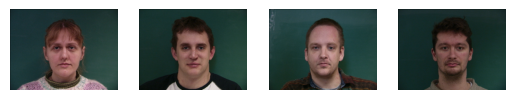

In [51]:
show_collection_of_images(morphed_images[:4])

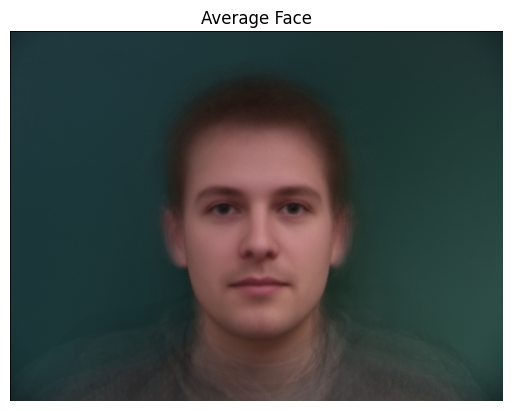

In [71]:
# compute the average face of the population and display it
average_face = np.mean(morphed_images, axis=0)
show_image(average_face, 'Average Face')
export_image(average_face, 'average_face', path=OUTPUT_PATH)


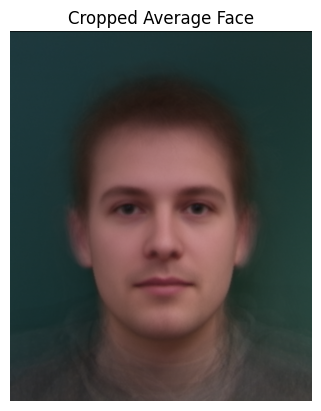

cropped_average_face shape:  (862, 704, 3)
cropped_ethan shape:  (862, 704, 4)


In [73]:
# change the average face to be compatible with the cropped_ethan shape
cropped_average_face = crop_image(average_face, cropped_ethan)
cropped_average_face = match_dimensions(cropped_average_face, cropped_ethan)
show_image(cropped_average_face, 'Cropped Average Face')
print("cropped_average_face shape: ", cropped_average_face.shape)
print("cropped_ethan shape: ", cropped_ethan.shape)

# save the cropped_average_face to a file
export_image(cropped_average_face, 'cropped_average_face', path=OUTPUT_PATH)


len of im1Points:  36


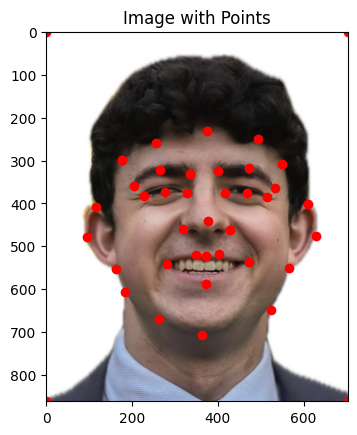

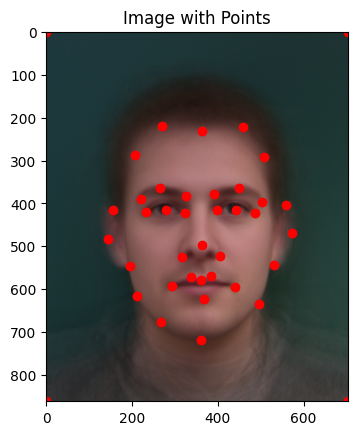

In [54]:
# import the points and display them
im1Points, im2Points = import_correspondences('cropped_ethan', 'cropped_average_face', cropped_ethan, cropped_average_face)

show_image_with_points(cropped_ethan, im1Points)
show_image_with_points(cropped_average_face, im2Points)



im1points length:  40
im2points length:  40


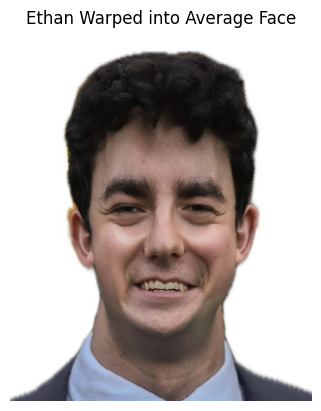

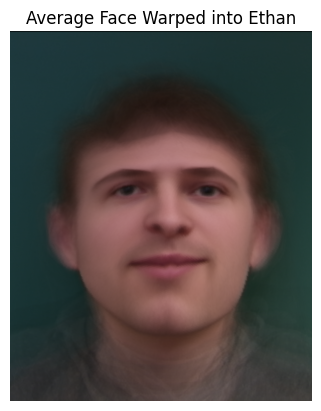

In [74]:
# my face (ethan) warped into the average face
print("im1points length: ", len(im1Points))
print("im2points length: ", len(im2Points))
ethan_warped_into_average = morphImages(im1Points, im2Points, cropped_ethan, cropped_average_face, warp_amount=1, dissolve_amount=0)[0]
show_image(ethan_warped_into_average, 'Ethan Warped into Average Face')
export_image(ethan_warped_into_average, 'ethan_warped_into_average', path=OUTPUT_PATH)
average_warped_into_ethan = morphImages(im2Points, im1Points, cropped_average_face, cropped_ethan, warp_amount=1, dissolve_amount=0)[0]
show_image(average_warped_into_ethan, 'Average Face Warped into Ethan')
export_image(average_warped_into_ethan, 'average_warped_into_ethan', path=OUTPUT_PATH)

# Part 5: Caricatures: Extrapolating from the mean

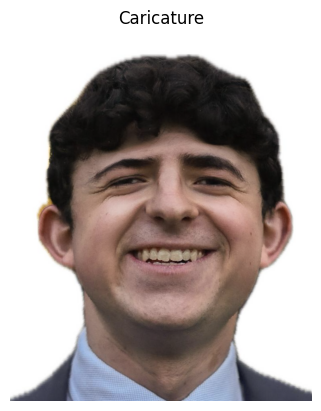

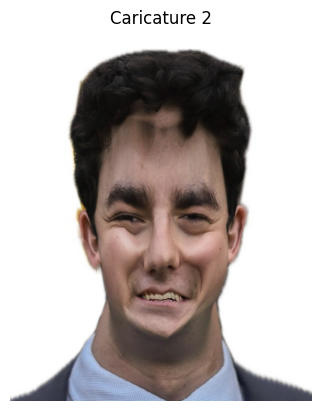

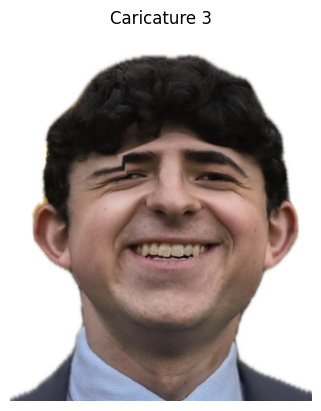

In [78]:
caricature = morphImages(im1Points, im2Points, cropped_ethan, cropped_average_face, warp_amount=-0.5, dissolve_amount=0)[0]
show_image(caricature, 'Caricature')
export_image(caricature, 'caricature', path=OUTPUT_PATH)
caricature2 = morphImages(im1Points, im2Points, cropped_ethan, cropped_average_face, warp_amount=1.5, dissolve_amount=0)[0]
show_image(caricature2, 'Caricature 2')
export_image(caricature2, 'caricature2', path=OUTPUT_PATH)
caricature3 = morphImages(im1Points, im2Points, cropped_ethan, cropped_average_face, warp_amount=-0.75, dissolve_amount=0)[0]
show_image(caricature3, 'Caricature 3')
export_image(caricature3, 'caricature3', path=OUTPUT_PATH)

# Bells and Whistles: Music Video

I will be making a video going through myself at different ages, I'm thinking maybe 20 images ill warp between them

filename:  Subject (4).jpeg
img shape:  (320, 319, 3)
converted from BGR to RGB
filename:  Subject.jpeg
img shape:  (320, 269, 3)
converted from BGR to RGB
filename:  Subject (2).jpeg
img shape:  (320, 310, 3)
converted from BGR to RGB
filename:  Subject (7).jpeg
img shape:  (320, 283, 3)
converted from BGR to RGB
filename:  Subject (5).jpeg
img shape:  (320, 291, 3)
converted from BGR to RGB
filename:  Subject (1).jpeg
img shape:  (320, 305, 3)
converted from BGR to RGB
filename:  Subject (3).jpeg
img shape:  (320, 282, 3)
converted from BGR to RGB


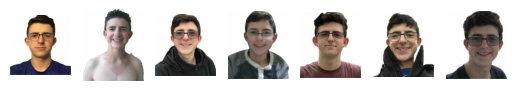

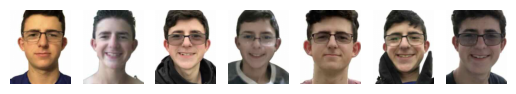

In [57]:
def get_face_box(img):
    # Convert image to 8-bit RGB
    img = (img * 255).astype(np.uint8)
    print("img shape: ", img.shape)
    if len(img.shape) == 2:  # If grayscale, convert to RGB
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
        print("converted from grayscale to RGB")
    elif img.shape[2] == 4:  # If RGBA, convert to RGB
        img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
        print("converted from RGBA to RGB")
    elif img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        print("converted from BGR to RGB")

    # get the landmarks
    faces = detector(img)
    if len(faces) != 1:
        raise ValueError("No face detected in the image.")
    face = faces[0]
    return face

def crop_face(image, face_box, padding=50):
    x1, y1, x2, y2 = face_box.left(), face_box.top(), face_box.right(), face_box.bottom()
    width = x2 - x1
    height = y2 - y1
    x1 = max(0, int(x1 - padding))
    y1 = max(0, int(y1 - padding))
    x2 = min(image.shape[1], int(x2 + padding))
    y2 = min(image.shape[0], int(y2 + padding))
    return image[y1:y2, x1:x2]


def clean_images():
    DIRECTORY_PATH = os.path.join(DATA_PATH, 'morph_video/')
    OUTPUT_PATH = os.path.join(DATA_PATH, 'morph_video_output/')
    
    cleaned_images = []
    original_images = []
    # crop all images in the directory
    for filename in os.listdir(DIRECTORY_PATH):
        print("filename: ", filename)
        img = load_image_as_float(os.path.join(os.path.join('morph_video/', filename)))
        original_images.append(img)
        face = get_face_box(img)
        img = crop_face(img, face)
        img = crop_image(img, cropped_ethan)
        img = match_dimensions(img, cropped_ethan)
        cleaned_images.append(img)
        export_image(img, filename, OUTPUT_PATH)
    return original_images, cleaned_images

original_images, cleaned_images = clean_images()
show_collection_of_images(original_images)
show_collection_of_images(cleaned_images)


img shape:  (862, 704, 3)
converted from BGR to RGB
img shape:  (862, 704, 3)
converted from BGR to RGB
img shape:  (862, 704, 3)
converted from BGR to RGB
img shape:  (862, 704, 3)
converted from BGR to RGB
img shape:  (862, 704, 3)
converted from BGR to RGB
img shape:  (862, 704, 3)
converted from BGR to RGB
img shape:  (862, 704, 3)
converted from BGR to RGB


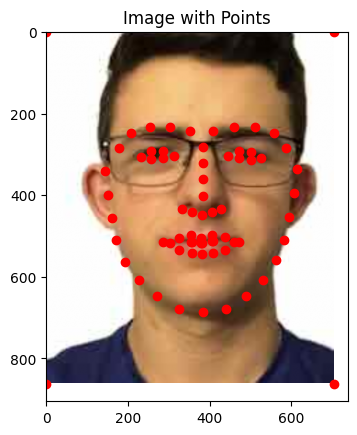

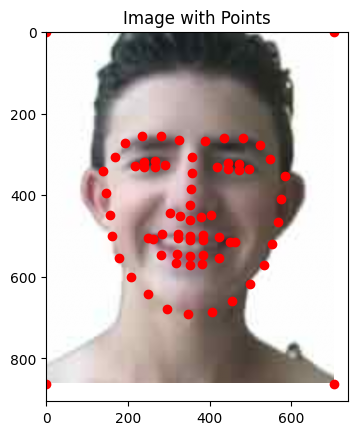

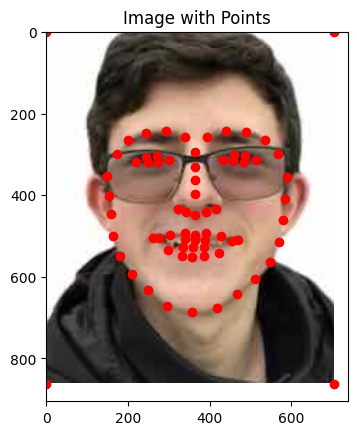

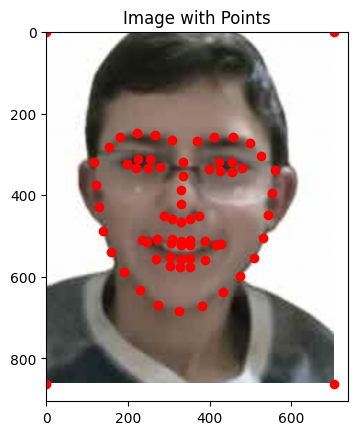

In [58]:
# use a CV model to map the points
def get_corner_points(img):
    # get the corners of the image
    corners = np.array([[0, 0], [0, img.shape[0]], [img.shape[1], 0], [img.shape[1], img.shape[0]]])
    return corners

def map_points(img, num_points=68):
    # Convert image to 8-bit RGB
    img = (img * 255).astype(np.uint8)
    print("img shape: ", img.shape)
    if len(img.shape) == 2:  # If grayscale, convert to RGB
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
        print("converted from grayscale to RGB")
    elif img.shape[2] == 4:  # If RGBA, convert to RGB
        img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
        print("converted from RGBA to RGB")
    elif img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        print("converted from BGR to RGB")

    # get the landmarks
    faces = detector(img)
    if len(faces) != 1:
        raise ValueError("No face detected in the image.")
    face = faces[0]
    landmarks = predictor(img, face)
    points = [(p.x, p.y) for p in landmarks.parts()]
    
    # extract n points
    indices = list(range(num_points))
    points = [points[i] for i in indices]
    points = np.array(points)

    # add the corner points
    points = np.vstack((points, get_corner_points(img)))
    
    return points


def map_points_images(images, num_points=68):
    pointgroups = []
    for img in images:
        pointgroups.append(map_points(img, num_points))
    return pointgroups


# points, face = map_points(cleaned_images[0])
# show_image_with_points(cleaned_images[0], points)


pointgroups = map_points_images(cleaned_images)
show_image_with_points(cleaned_images[0], pointgroups[0])
show_image_with_points(cleaned_images[1], pointgroups[1])
show_image_with_points(cleaned_images[2], pointgroups[2])
show_image_with_points(cleaned_images[3], pointgroups[3])

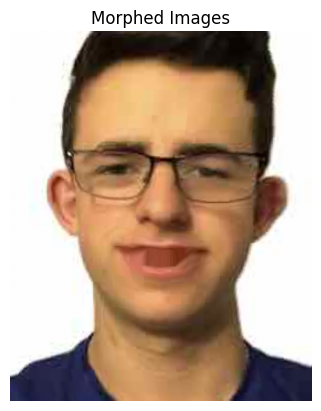

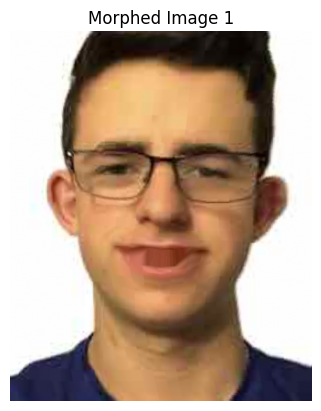

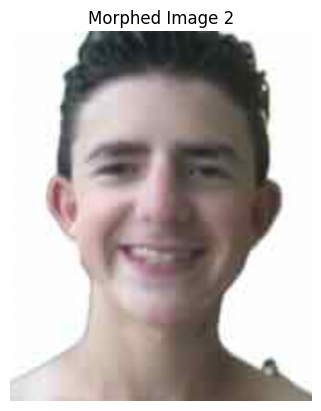

In [59]:
morphed_image, morphed_image1, morphed_image2 = morphImages(pointgroups[0], pointgroups[1], cleaned_images[0], cleaned_images[1], warp_amount=1, dissolve_amount=0)
show_image(morphed_image, 'Morphed Images')
show_image(morphed_image1, 'Morphed Image 1')
show_image(morphed_image2, 'Morphed Image 2')


In [60]:

# # output the points to a JSON file
# def prepare_JSON(images, num_points=100):
#     correspondences_JSON = {}

#     # "im1_name": "image1",
#     # "im2_name": "image2",
#     # "im1Points": [[x1, y1], [x2, y2], ..., [xn, yn]],
#     # "im2Points": [[x1, y1], [x2, y2], ..., [xn, yn]]
    
#     for i, img in enumerate(images):
#         points = map_points(img, num_points)
#         # append the name to the correspondences_JSON
#         correspondences_JSON[f"image{i+1}"] = {
#             f"im{i+1}_name": f"image{i+1}",
#             f"im{i+1}Points": points,
#         }
#     return correspondences_JSON
    

In [61]:
import concurrent.futures
from functools import partial

def morphCollage(images, pointgroups, num_frames=20):
    frames = []
    
    def process_pair(i):
        pair_frames = morphVideo(pointgroups[i], pointgroups[i+1], images[i], images[i+1], num_frames)
        print(f"Processed {i+1} of {len(images)-1} image pairs")
        return i, pair_frames
    
    with concurrent.futures.ThreadPoolExecutor() as executor:
        future_to_index = {executor.submit(process_pair, i): i for i in range(len(images)-1)}
        
        for future in concurrent.futures.as_completed(future_to_index):
            index, pair_frames = future.result()
            frames.append((index, pair_frames))
    
    # Sort the frames based on the original order
    frames.sort(key=lambda x: x[0])
    
    # Flatten the list of frames
    return [frame for _, pair_frames in frames for frame in pair_frames]

morphed_collage = morphCollage(cleaned_images, pointgroups)


No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.No valid colors found for some pixels.

No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for some pixels.
No valid colors found for

morphed_collage length:  120


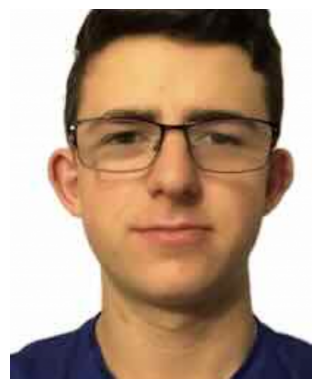

Video saved as morphed_collage.mp4


In [86]:
print("morphed_collage length: ", len(morphed_collage))
show_image(morphed_collage[0])

# save the images to a video not a gif
def save_frames_to_video(frames, output_filename, fps=30):
    output_path = os.path.join(OUTPUT_PATH, output_filename )
    # Get the dimensions of the first frame
    height, width = frames[0].shape[:2]
    
    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    
    for frame in frames:
        # Convert the frame to uint8 if it's not already
        if frame.dtype != np.uint8:
            frame = (frame * 255).astype(np.uint8)
        
        # OpenCV uses BGR color format
        if frame.shape[2] == 3:
            frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
        
        # Write the frame
        out.write(frame)
    
    # Release the VideoWriter
    out.release()
    print(f"Video saved as {output_filename}")

# Use the function to save your morphed collage
output_filename = 'morphed_collage.mp4'
save_frames_to_video(morphed_collage, output_filename)

    

In [63]:
import cv2
import dlib
import json

def map_facial_features(img1, img2, im1_name='image1', im2_name='image2'):
    """
    Maps facial features between two images and returns a dictionary containing
    the corresponding points.

    Args:
        img1 (numpy.ndarray): The first face image array.
        img2 (numpy.ndarray): The second face image array.
        im1_name (str): Optional name for the first image.
        im2_name (str): Optional name for the second image.

    Returns:
        dict: A dictionary containing image names and lists of corresponding points.
    """

    # Initialize Dlib's face detector and shape predictor
    detector = dlib.get_frontal_face_detector()
    predictor_path = 'shape_predictor_68_face_landmarks.dat'  # Ensure this file is in your working directory
    predictor = dlib.shape_predictor(predictor_path)

    # Convert images to grayscale if they are in color
    if len(img1.shape) == 3:
        gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    else:
        gray1 = img1.copy()

    if len(img2.shape) == 3:
        gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    else:
        gray2 = img2.copy()

    # Detect faces in both images
    faces1 = detector(gray1)
    faces2 = detector(gray2)

    # Ensure that at least one face is detected in each image
    if len(faces1) == 0 or len(faces2) == 0:
        raise ValueError("No face detected in one of the images.")

    # Assume the first detected face in each image
    face1 = faces1[0]
    face2 = faces2[0]

    # Get facial landmarks
    landmarks1 = predictor(gray1, face1)
    landmarks2 = predictor(gray2, face2)

    # Define indices of the 30 facial points to extract
    points_idx = [
        0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,  # Jawline
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26,             # Eyebrows
        27, 28, 29, 30,                                     # Nose bridge
        31, 32                                              # Nose bottom
    ]

    # Extract corresponding points from both images
    im1Points = [[landmarks1.part(idx).x, landmarks1.part(idx).y] for idx in points_idx]
    im2Points = [[landmarks2.part(idx).x, landmarks2.part(idx).y] for idx in points_idx]

    # Prepare the output dictionary
    output_dict = {
        "im1_name": im1_name,
        "im2_name": im2_name,
        "im1Points": im1Points,
        "im2Points": im2Points
    }

    return output_dict

# Example usage:
# Load your images as numpy arrays
# img1 = cv2.imread('path/to/your/first/image.jpg')
# img2 = cv2.imread('path/to/your/second/image.jpg')

# Map facial features
output = map_facial_features(cropped_ethan, mahomes, im1_name='cropped_ethan', im2_name='cropped_mahomes')

# Print the result
print(json.dumps(output, indent=4))


error: OpenCV(4.8.1) /Users/xperience/GHA-OpenCV-Python/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/color.simd_helpers.hpp:94: error: (-2:Unspecified error) in function 'cv::impl::(anonymous namespace)::CvtHelper<cv::impl::(anonymous namespace)::Set<3, 4, -1>, cv::impl::(anonymous namespace)::Set<1, -1, -1>, cv::impl::(anonymous namespace)::Set<0, 2, 5>, cv::impl::(anonymous namespace)::NONE>::CvtHelper(cv::InputArray, cv::OutputArray, int) [VScn = cv::impl::(anonymous namespace)::Set<3, 4, -1>, VDcn = cv::impl::(anonymous namespace)::Set<1, -1, -1>, VDepth = cv::impl::(anonymous namespace)::Set<0, 2, 5>, sizePolicy = cv::impl::(anonymous namespace)::NONE]'
> Unsupported depth of input image:
>     'VDepth::contains(depth)'
> where
>     'depth' is 6 (CV_64F)
